In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import imutils
import csv
import glob
import os
import pandas as pd
from skimage import io

In [2]:
for file in os.listdir('./WikiArt/WikiArt'):
    if file.startswith('.'):
        continue
    print(file, len(os.listdir(f'./WikiArt/WikiArt/{file}')))

Analytical_Cubism 110
Expressionism 5396
All 9911
Action_painting 98
Color_Field_Painting 1615
Abstract_Expressionism 2782


In [3]:
import turicreate as tc

# Load images from the downloaded data
reference_data  = tc.image_analysis.load_images('./WikiArt/WikiArt/All')
reference_data = reference_data.add_row_number()

# Save the SFrame for future use
# reference_data.save('./caltech-101.sframe')

Read 3656 images in 5.00561 secs	speed: 730.381 file/sec

Read 5480 images in 10.0858 secs	speed: 359.039 file/sec

Read 5680 images in 15.3288 secs	speed: 38.1466 file/sec

Read 5896 images in 20.3532 secs	speed: 42.9903 file/sec

Read 6072 images in 25.3944 secs	speed: 34.9122 file/sec

Read 6240 images in 30.6776 secs	speed: 31.7988 file/sec

Read 6312 images in 35.9102 secs	speed: 13.7599 file/sec

Read 6488 images in 40.9321 secs	speed: 35.0464 file/sec

Read 6560 images in 47.6024 secs	speed: 10.7941 file/sec

Read 6584 images in 55.6978 secs	speed: 2.96464 file/sec

Read 6656 images in 62.6903 secs	speed: 10.2967 file/sec

Read 6768 images in 68.3777 secs	speed: 19.6926 file/sec

Read 6848 images in 73.9706 secs	speed: 14.3038 file/sec

Read 6896 images in 79.2226 secs	speed: 9.13949 file/sec

Read 6968 images in 84.4307 secs	speed: 13.8245 file/sec

Read 7048 images in 89.5482 secs	speed: 15.6328 file/sec

Read 7112 images in 94.7246 secs	speed: 12.3637 file/sec

Read 7176 images in 100.134 secs	speed: 11.8322 file/sec

Read 7224 images in 105.733 secs	speed: 8.57269 file/sec

Read 7256 images in 111.315 secs	speed: 5.73294 file/sec

Read 7288 images in 117.016 secs	speed: 5.61287 file/sec

Read 7328 images in 122.818 secs	speed: 6.89415 file/sec

Read 7352 images in 128.187 secs	speed: 4.46998 file/sec

Read 7432 images in 133.647 secs	speed: 14.6508 file/sec

Read 7488 images in 139.026 secs	speed: 10.4111 file/sec

Read 7584 images in 144.273 secs	speed: 18.2977 file/sec

Read 7624 images in 149.486 secs	speed: 7.6727 file/sec

Read 7664 images in 154.541 secs	speed: 7.91368 file/sec

Read 7736 images in 160.08 secs	speed: 12.9971 file/sec

Read 7792 images in 166.598 secs	speed: 8.59167 file/sec

Read 7816 images in 172.799 secs	speed: 3.8705 file/sec

Read 7840 images in 177.999 secs	speed: 4.61579 file/sec

Read 7880 images in 183.329 secs	speed: 7.50349 file/sec

Read 7928 images in 189.62 secs	speed: 7.62993 file/sec

Read 7960 images in 197.18 secs	speed: 4.23293 file/sec

Read 7984 images in 203.477 secs	speed: 3.81132 file/sec

Read 8008 images in 209.585 secs	speed: 3.92914 file/sec

Read 8032 images in 217.352 secs	speed: 3.09009 file/sec

Read 8056 images in 223.646 secs	speed: 3.81304 file/sec

Read 8088 images in 229.088 secs	speed: 5.88105 file/sec

Read 8112 images in 235.263 secs	speed: 3.88608 file/sec

Read 8128 images in 241.928 secs	speed: 2.40092 file/sec

Read 8152 images in 247.613 secs	speed: 4.22112 file/sec

Read 8176 images in 255.154 secs	speed: 3.18263 file/sec

Read 8192 images in 261.439 secs	speed: 2.54588 file/sec

Read 8208 images in 268.276 secs	speed: 2.34014 file/sec

Read 8232 images in 275.016 secs	speed: 3.56088 file/sec

Read 8248 images in 280.651 secs	speed: 2.83958 file/sec

Read 8264 images in 289.4 secs	speed: 1.82865 file/sec

Read 8320 images in 298.009 secs	speed: 6.50502 file/sec

Read 8328 images in 303.465 secs	speed: 1.46616 file/sec

Read 8344 images in 310.957 secs	speed: 2.13564 file/sec

Read 8368 images in 316.131 secs	speed: 4.63853 file/sec

Read 8448 images in 321.274 secs	speed: 15.5556 file/sec

Read 8488 images in 327.321 secs	speed: 6.61554 file/sec

Read 8504 images in 340.886 secs	speed: 1.17949 file/sec

Read 8512 images in 352.166 secs	speed: 0.709221 file/sec

Read 8520 images in 379.829 secs	speed: 0.289191 file/sec

Read 8528 images in 389.564 secs	speed: 0.821806 file/sec

Read 8536 images in 414.412 secs	speed: 0.321953 file/sec

Read 8544 images in 436.998 secs	speed: 0.354201 file/sec

Read 8552 images in 467.025 secs	speed: 0.266431 file/sec

Read 8560 images in 500.551 secs	speed: 0.238621 file/sec

Read 8568 images in 527.014 secs	speed: 0.302303 file/sec

Read 8576 images in 562.704 secs	speed: 0.224153 file/sec

Read 8584 images in 581.058 secs	speed: 0.435874 file/sec

Read 8592 images in 603.226 secs	speed: 0.360886 file/sec

Read 8616 images in 608.6 secs	speed: 4.46619 file/sec

Read 8656 images in 615.474 secs	speed: 5.81908 file/sec

Read 8672 images in 621.207 secs	speed: 2.79059 file/sec

Read 8704 images in 626.435 secs	speed: 6.12057 file/sec

Read 8736 images in 631.572 secs	speed: 6.23012 file/sec

Read 8776 images in 637.679 secs	speed: 6.54915 file/sec

Read 8792 images in 643.928 secs	speed: 2.56075 file/sec

Read 8800 images in 650.337 secs	speed: 1.24822 file/sec

Read 8808 images in 655.918 secs	speed: 1.43322 file/sec

Read 8824 images in 664.451 secs	speed: 1.87519 file/sec

Read 8840 images in 672.302 secs	speed: 2.03789 file/sec

Read 8856 images in 680.681 secs	speed: 1.90948 file/sec

Read 8872 images in 685.808 secs	speed: 3.1213 file/sec

Read 8896 images in 690.925 secs	speed: 4.68978 file/sec

Read 8920 images in 696.564 secs	speed: 4.25608 file/sec

Read 8944 images in 704.893 secs	speed: 2.88142 file/sec

Read 8984 images in 710.415 secs	speed: 7.24381 file/sec

Read 9040 images in 715.699 secs	speed: 10.5992 file/sec

Read 9072 images in 730.453 secs	speed: 2.16885 file/sec

Read 9096 images in 738.796 secs	speed: 2.87656 file/sec

Read 9136 images in 743.864 secs	speed: 7.89322 file/sec

Read 9160 images in 750.061 secs	speed: 3.87308 file/sec

Read 9176 images in 756.278 secs	speed: 2.57327 file/sec

Read 9192 images in 761.732 secs	speed: 2.9338 file/sec

Read 9208 images in 767.2 secs	speed: 2.92609 file/sec

Read 9224 images in 772.354 secs	speed: 3.10458 file/sec

Read 9248 images in 779.18 secs	speed: 3.51597 file/sec

Read 9272 images in 784.545 secs	speed: 4.47318 file/sec

Read 9296 images in 790.287 secs	speed: 4.17969 file/sec

Read 9320 images in 795.68 secs	speed: 4.45019 file/sec

Read 9344 images in 802.032 secs	speed: 3.77824 file/sec

Read 9368 images in 809.776 secs	speed: 3.09911 file/sec

Read 9384 images in 815.221 secs	speed: 2.93862 file/sec

Read 9408 images in 821.442 secs	speed: 3.85825 file/sec

Read 9432 images in 827.713 secs	speed: 3.82664 file/sec

Read 9448 images in 833.439 secs	speed: 2.79452 file/sec

Read 9472 images in 841.005 secs	speed: 3.17196 file/sec

Read 9496 images in 847.345 secs	speed: 3.78585 file/sec

Read 9528 images in 854.69 secs	speed: 4.35668 file/sec

Read 9536 images in 866.636 secs	speed: 0.669677 file/sec

Read 9552 images in 871.835 secs	speed: 3.07756 file/sec

Read 9584 images in 877.675 secs	speed: 5.47945 file/sec

Read 9608 images in 883.703 secs	speed: 3.98142 file/sec

Read 9640 images in 889.182 secs	speed: 5.84026 file/sec

Read 9672 images in 894.255 secs	speed: 6.30764 file/sec

Read 9712 images in 903.849 secs	speed: 4.16943 file/sec

Read 9728 images in 909.584 secs	speed: 2.78991 file/sec

Read 9744 images in 916.923 secs	speed: 2.17989 file/sec

Read 9752 images in 924.118 secs	speed: 1.11199 file/sec

Read 9768 images in 929.273 secs	speed: 3.10358 file/sec

Read 9784 images in 936.531 secs	speed: 2.20458 file/sec

Read 9800 images in 943.345 secs	speed: 2.34798 file/sec

Read 9816 images in 949.158 secs	speed: 2.75232 file/sec

Read 9840 images in 955.212 secs	speed: 3.96438 file/sec

Read 9872 images in 960.437 secs	speed: 6.12483 file/sec

Read 9896 images in 967.55 secs	speed: 3.374 file/sec

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/turicreate/visualization/_plot.py:461: UserWarning: Displaying only the first 100 rows.
  warnings.warn("Displaying only the first {} rows.".format(maximum_rows))


,id,path,image
0,0,/Users/cotraak/Desktop/UCDSC/WikiArt/WikiArt/All/aaron-siskind_acolman-1-1955.jpg,
1,1,/Users/cotraak/Desktop/UCDSC/WikiArt/WikiArt/All/aaron-siskind_chicago-1951.jpg,
2,2,/Users/cotraak/Desktop/UCDSC/WikiArt/WikiArt/All/aaron-siskind_chicago-6-1961.jpg,
3,3,/Users/cotraak/Desktop/UCDSC/WikiArt/WikiArt/All/aaron-siskind_feet-102-1957.jpg,
4,4,/Users/cotraak/Desktop/UCDSC/WikiArt/WikiArt/All/aaron-siskind_gloucester-16a-1944.jpg,
5,5,/Users/cotraak/Desktop/UCDSC/WikiArt/WikiArt/All/aaron-siskind_jerome-arizona-1949.jpg,
6,6,/Users/cotraak/Desktop/UCDSC/WikiArt/WikiArt/All/aaron-siskind_kentucky-4-1951.jpg,
7,7,/Users/cotraak/Desktop/UCDSC/WikiArt/WikiArt/All/aaron-siskind_new-york-1951.jpg,
8,8,/Users/cotraak/Desktop/UCDSC/WikiArt/WikiArt/All/aaron-siskind_new-york-2-1948.jpg,
9,9,/Users/cotraak/Desktop/UCDSC/WikiArt/WikiArt/All/aaron-siskind_new-york-24-1988.jpg,

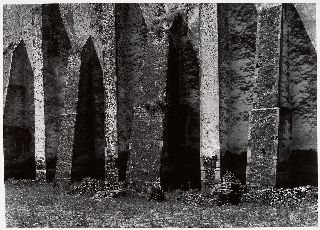
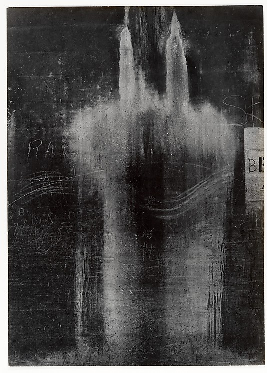
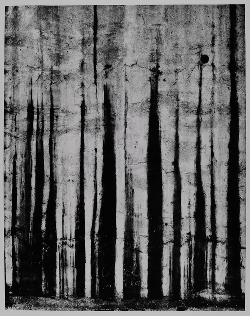
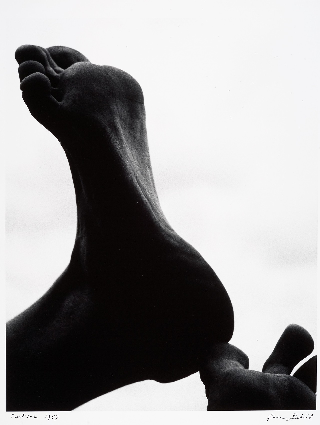
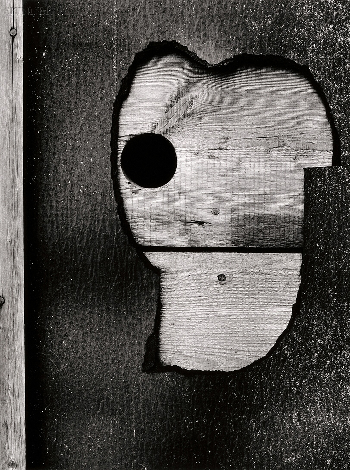
...
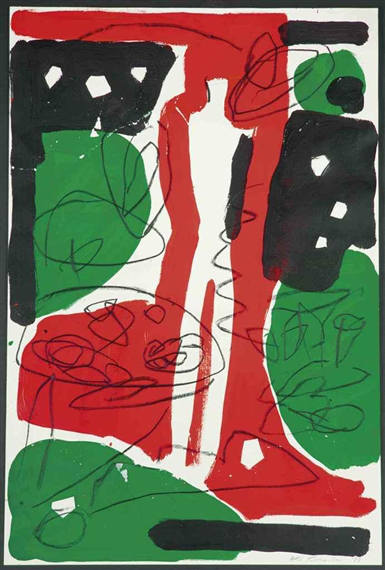
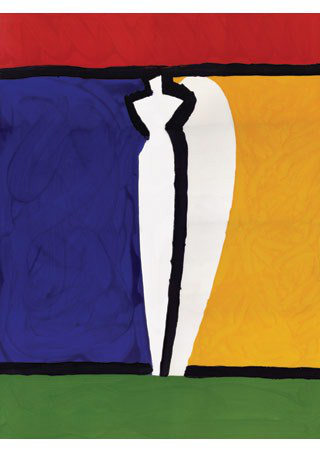
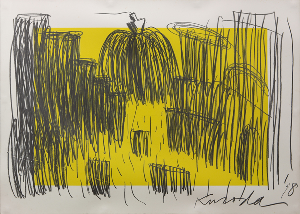
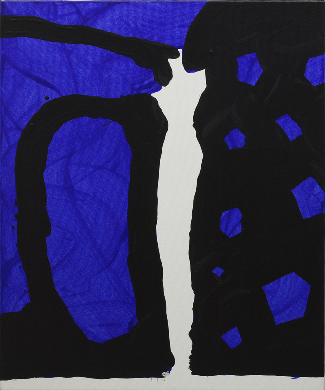
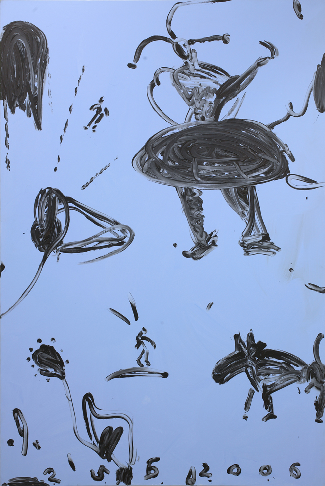

['__bool__',
 '__class__',
 '__delattr__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__']

In [4]:
dir(reference_data.explore())

In [5]:
model = tc.image_similarity.create(reference_data)

Using GPU (Apple M1) to extract features.

Analyzing and extracting image features.

+------------------+--------------+------------------+

| Images Processed | Elapsed Time | Percent Complete |

+------------------+--------------+------------------+

| 64               | 598.476ms    | 0.5%             |

| 128              | 736.888ms    | 1.25%            |

| 192              | 873.215ms    | 1.75%            |

| 256              | 1.00s        | 2.5%             |

| 320              | 1.14s        | 3%               |

| 640              | 1.82s        | 6.25%            |

| 1600             | 3.93s        | 16%              |

| 3200             | 7.35s        | 32.25%           |

| 4800             | 11.03s       | 48.25%           |

| 6400             | 14.70s       | 64.5%            |

| 8000             | 18.32s       | 80.5%            |

| 9600             | 23.21s       | 96.75%           |

| 9910             | 26.50s       | 100%             |

+------------------+--------------+------------------+

Starting brute force nearest neighbors model training.

Validating distance components.

Initializing model data.

Initializing distances.

Done.

In [6]:
reference_data[reference_data['path'].apply(lambda x: 'target-2.png' in x)]['path']

dtype: str
Rows: ?
['/Users/cotraak/Desktop/UCDSC/WikiArt/WikiArt/All/target-2.png', ... ]

In [11]:
query_results = model.query(reference_data[reference_data['path'].apply(lambda x: 'target-4.png' in x)], k=10)
query_results.head()

Analyzing and extracting image features.

+------------------+--------------+------------------+

| Images Processed | Elapsed Time | Percent Complete |

+------------------+--------------+------------------+

| 1                | 106.344ms    | 100%             |

+------------------+--------------+------------------+

Starting pairwise querying.

+--------------+---------+-------------+--------------+

| Query points | # Pairs | % Complete. | Elapsed Time |

+--------------+---------+-------------+--------------+

| 0            | 1       | 0.0100908   | 20.294ms     |

| Done         |         | 100         | 250.551ms    |

+--------------+---------+-------------+--------------+

query_label,reference_label,distance,rank
0,9529,0.0,1
0,5869,15.493418619171743,2
0,5834,15.761982618399426,3
0,1209,16.216869102165713,4
0,9800,16.22012002787568,5
0,3989,16.23556592117752,6
0,4031,16.33948193070391,7
0,5341,16.452594377604626,8
0,4588,16.523966905224846,9
0,9772,16.585527651055756,10


In [12]:
query_results.shape

(10, 4)

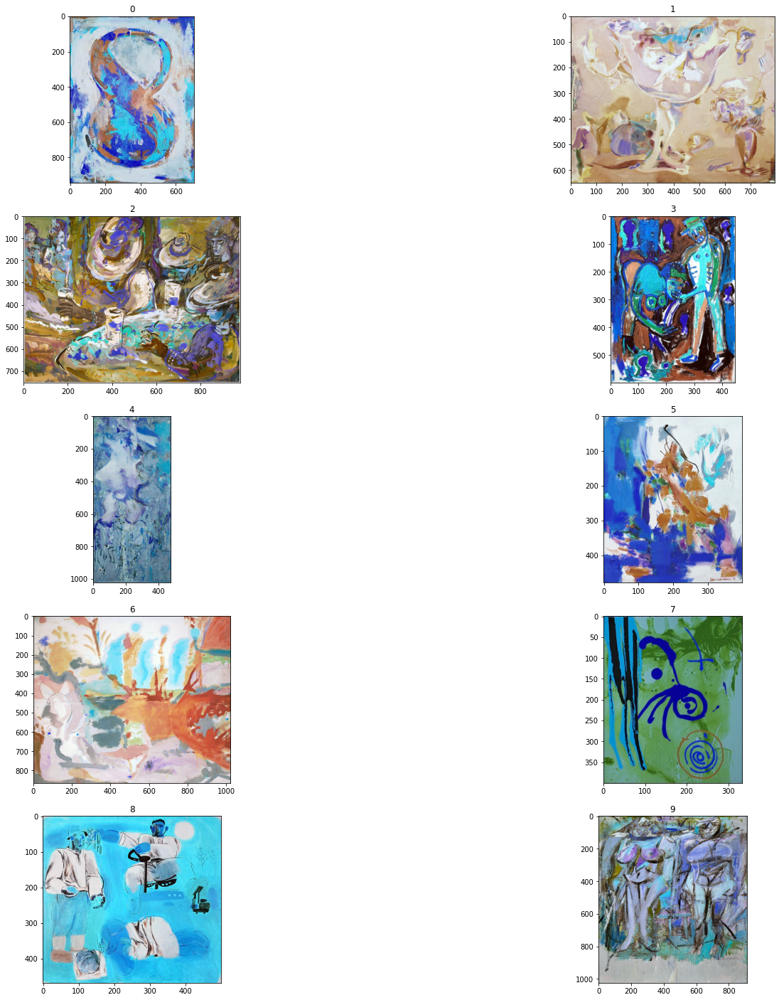

In [13]:
import cv2
import matplotlib.pyplot as plt
imgs = []
for i in range(query_results.shape[0]):
    result = cv2.imread(reference_data[query_results['reference_label'][i]]['path'])
    imgs.append(result)
    
    
    
fig, m_axs = plt.subplots(5,2, figsize = (25, 25))
m_axs = m_axs.flatten()
ind=0
for img, ax in zip(imgs, m_axs):
    ax.imshow(img,cmap=None)
    ax.set_title(f'{ind}')
    ind=ind+1

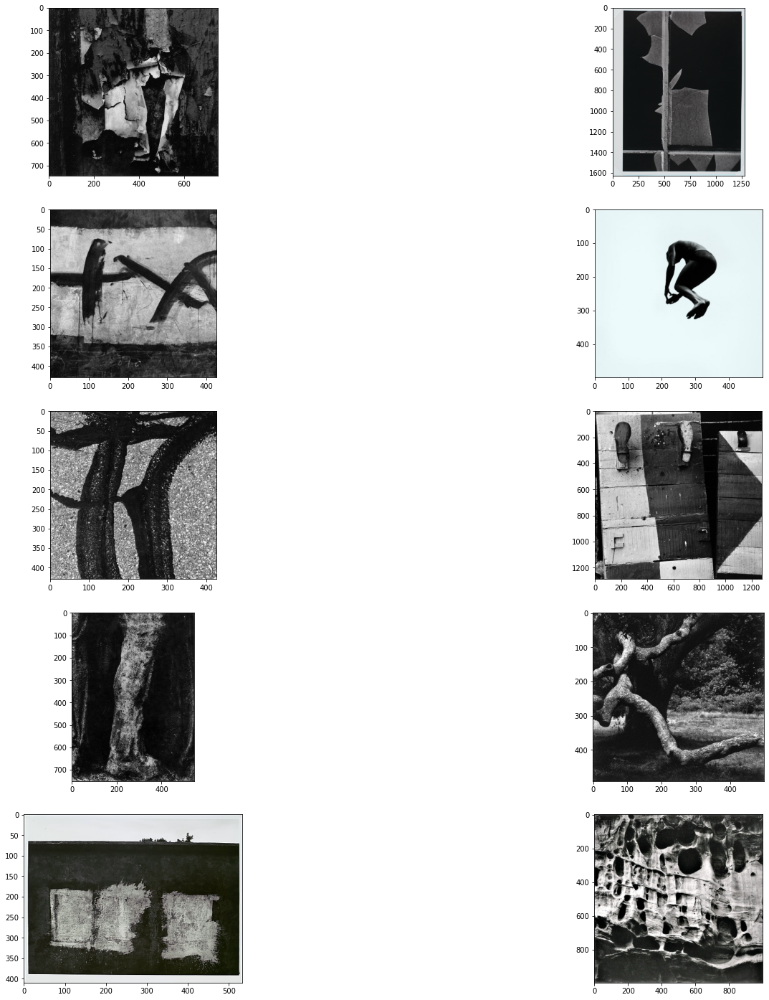

In [10]:
import cv2
import matplotlib.pyplot as plt
imgs = []
for i in range(query_results.shape[0]):
    result = cv2.imread(reference_data[i+10]['path']) #getting other images in file
    imgs.append(result)
    
    
    
fig, m_axs = plt.subplots(5,2, figsize = (25, 25))
m_axs = m_axs.flatten()
ind=0
for img, ax in zip(imgs, m_axs):
    ax.imshow(img,cmap=None)
#     ax.set_title(f'{ind}')
    ind=ind+1